# Lab 3 - Choropleths
## By Ivan Midtbust Heger, Trey Hoopchuck, Evan 
## Examining Child and adolescent obesity and BMI data in the world


Link to the data used - http://www.ncdrisc.org/data-downloads-adiposity-ado.html

In [2]:
%matplotlib inline
import pandas as gd
import geopandas
from plotnine import *
import matplotlib

In [3]:
df = gd.read_csv("CSV Files/world_obesity.txt") #Read in the file
df #Display the data set

,Country/Region/World,ISO,Sex,Year,Mean BMI,Mean BMI lower 95% uncertainty interval,Mean BMI upper 95% uncertainty interval,Prevalence of BMI>2SD (obesity),Prevalence of BMI>2SD lower 95% uncertainty interval,Prevalence of BMI>2SD upper 95% uncertainty interval,...,Prevalence of minus1SD<BMI<1SD upper 95% uncertainty interval,Prevalence of minus2SD<BMI<minus1SD,Prevalence of minus2SD<BMI<minus1SD lower 95% uncertainty interval,Prevalence of minus2SD<BMI<minus1SD upper 95% uncertainty interval,Prevalence of BMI<minus1SD (underweight),Prevalence of BMI<minus1SD lower 95% uncertainty interval,Prevalence of BMI<minus1SD upper 95% uncertainty interval,Prevalence of BMI<minus2SD (moderate & severe underweight),Prevalence of BMI<minus2SD lower 95% uncertainty interval,Prevalence of BMI<minus2SD upper 95% uncertainty interval
0,Afghanistan,AFG,Boys,1975,15.045565,12.512560,17.552854,0.000517,0.000003,0.003211,...,0.452694,0.382075,0.240744,0.548096,0.701622,0.543184,0.845123,0.319547,0.134384,0.498794
1,Afghanistan,AFG,Boys,1976,15.084892,12.634216,17.534976,0.000560,0.000004,0.003240,...,0.451834,0.380632,0.243738,0.542044,0.698587,0.544105,0.837919,0.317956,0.137219,0.492346
2,Afghanistan,AFG,Boys,1977,15.123787,12.755636,17.502263,0.000611,0.000006,0.003540,...,0.451514,0.379172,0.245647,0.535515,0.695497,0.544872,0.831829,0.316325,0.140390,0.486938
3,Afghanistan,AFG,Boys,1978,15.162724,12.874059,17.470846,0.000671,0.000008,0.003754,...,0.450514,0.377684,0.247541,0.528804,0.692353,0.544228,0.826128,0.314669,0.141116,0.482551
4,Afghanistan,AFG,Boys,1979,15.202452,12.981646,17.462874,0.000740,0.000010,0.004005,...,0.448919,0.376138,0.249439,0.523514,0.689128,0.544682,0.819239,0.312990,0.144076,0.477112
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16795,Zimbabwe,ZWE,Girls,2012,18.397532,17.523243,19.282932,0.047494,0.016632,0.100410,...,0.710953,0.147573,0.098637,0.201325,0.172943,0.120780,0.231131,0.025371,0.008529,0.053849
16796,Zimbabwe,ZWE,Girls,2013,18.403608,17.527503,19.300005,0.051572,0.017634,0.109708,...,0.710982,0.143132,0.092936,0.198523,0.166850,0.113879,0.227143,0.023718,0.007467,0.051700
16797,Zimbabwe,ZWE,Girls,2014,18.412239,17.528672,19.308319,0.055903,0.018745,0.119722,...,0.711459,0.138744,0.087909,0.195503,0.160923,0.106772,0.221977,0.022179,0.006387,0.049882
16798,Zimbabwe,ZWE,Girls,2015,18.422837,17.526655,19.319873,0.060503,0.019798,0.130000,...,0.711302,0.134411,0.081897,0.193685,0.155169,0.099421,0.218065,0.020758,0.005504,0.048322


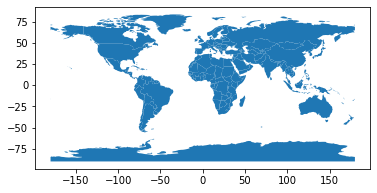

In [11]:
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres')) #Create a global map data set
world.plot()

In [5]:
#Create a list of the country names from both datasets
world_countries = world["name"].tolist()
df_countries = df["Country/Region/World"].tolist()

#loop through to check if the country in our obesity dataset is the same as the country in the world dataset and add to list
countries = []
for c in world_countries:
    if c in df_countries:
        countries.append(c)

#Removing countires not in the gepanda
new_df = df[df["Country/Region/World"] == countries[0]]
for c in countries[1:len(countries)]:
    new_df = new_df.append(df[df["Country/Region/World"] == c])
new_df = new_df.rename(columns = {"Country/Region/World" : "name"})

new_world = world[world["name"] == countries[0]]
for c in countries[1:len(countries)]:
    new_world = new_world.append(world[world["name"] == c])

In [6]:
#Make a dictionary of datasets of each individual year seperated by sex and formatted so I can reference each year easier
dataset = {}
for x in range(1975, 2017):
    test = new_df[new_df["Year"]==x]
    testboy = test[test["Sex"] == "Boys"]
    testgirl = test[test["Sex"] == "Girls"]
    finalboys = world.join(testboy.set_index('name'), on='name')
    finalgirls = world.join(testgirl.set_index('name'), on='name')
    dataset[str(x) + "boy"] = finalboys.to_crs("EPSG:3857")
    dataset[str(x) + "girl"] = finalgirls.to_crs("EPSG:3857")

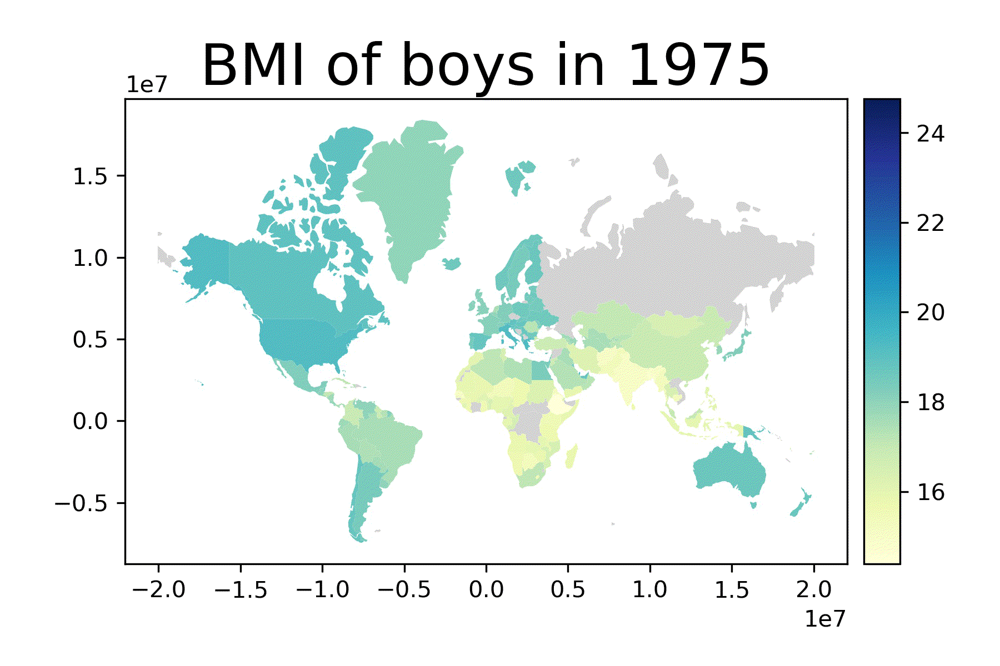

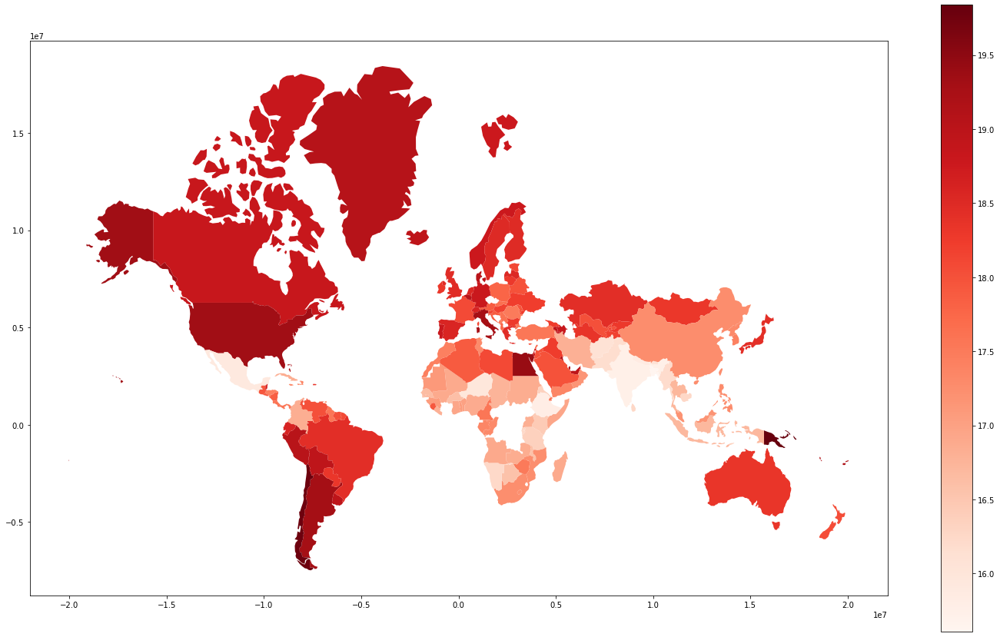

In [8]:
dataset["1975girl"].plot(column="Mean BMI", legend = True, cmap="Reds", figsize=(25, 15))

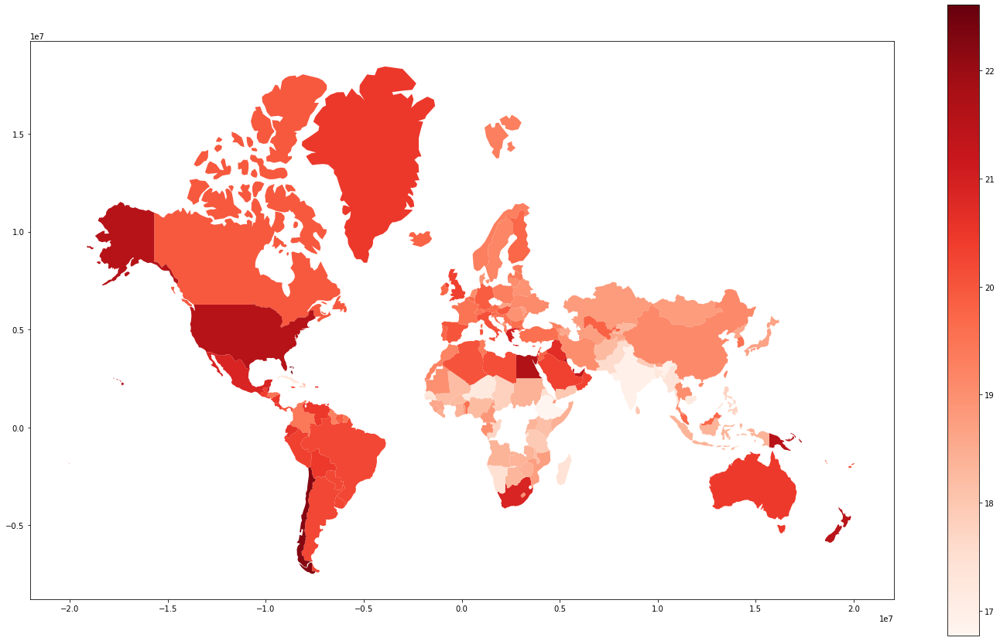

In [9]:
dataset["2016girl"].plot(column="Mean BMI", legend = True, cmap="Reds", figsize=(25, 15))

# This is a gif showing the mean BMI of girls from 1975 to 2016 using our datasets. This was created by my lab partners so I don't have the implementation for it in this lab but the gif is a very good tool to visualize the changes over time so I wanted to include it.

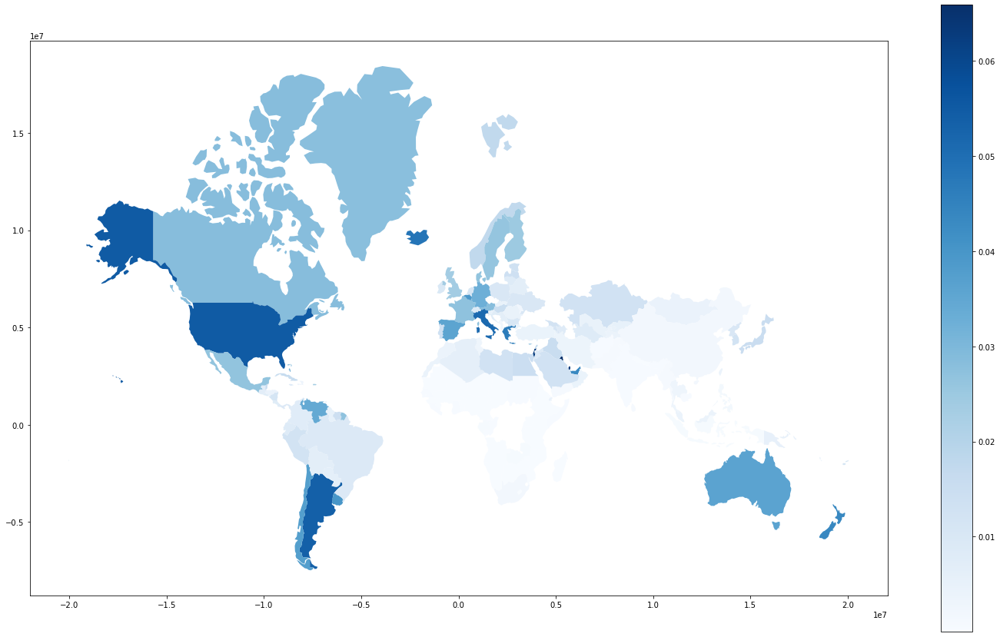

In [290]:
#Graph the Prevalence of obesity of all boys, in all countries included in the dataset and world, in 1975.
dataset["1975boy"].plot(column="Prevalence of BMI>2SD (obesity)", legend = True, cmap="Blues", figsize=(25, 15))

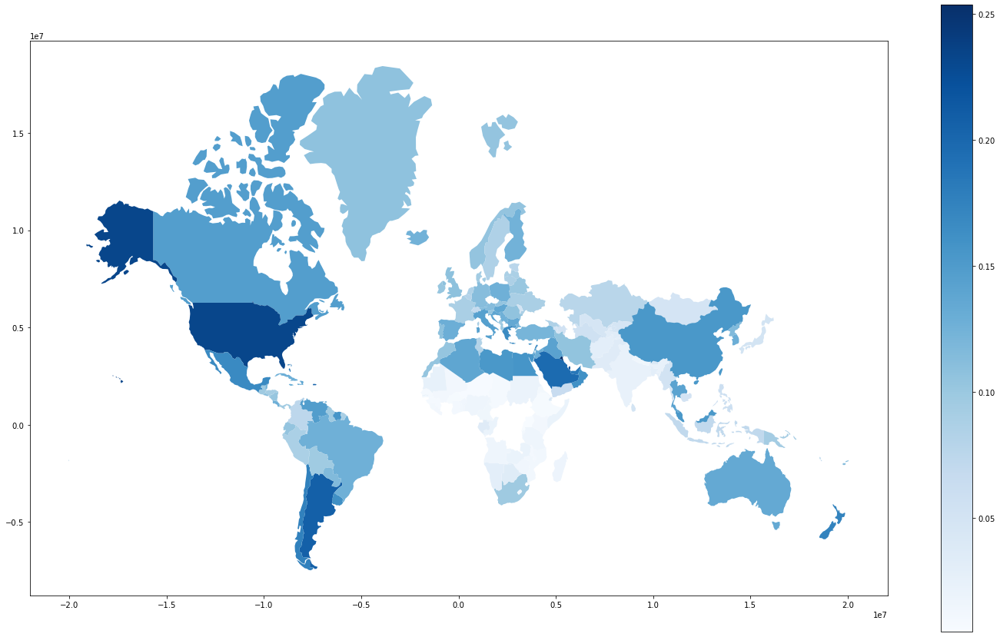

In [291]:
#Graph the Prevalence of obesity of all boys, in all countries included in the dataset and world, in 2016.
dataset["2016boy"].plot(column="Prevalence of BMI>2SD (obesity)", legend = True, cmap="Blues", figsize=(25, 15))

# These graphs show the prevelance of BMI numbers indicating obesity in different countries in boys

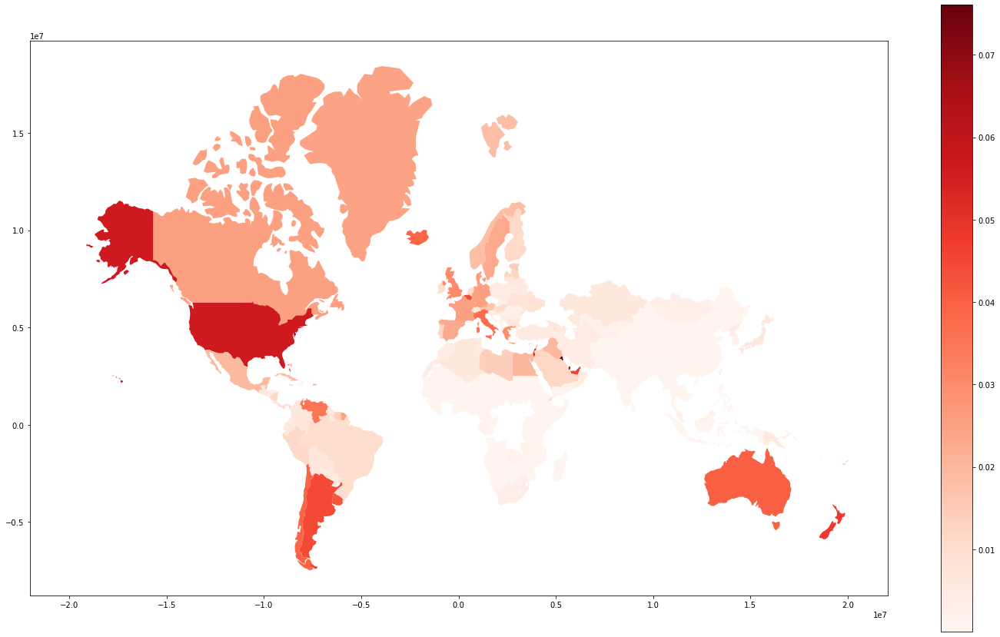

In [292]:
#Graph the Prevalence of obesity of all boys, in all countries included in the dataset and world, in 1975.
dataset["1975girl"].plot(column="Prevalence of BMI>2SD (obesity)", legend = True, cmap="Reds", figsize=(25, 15))

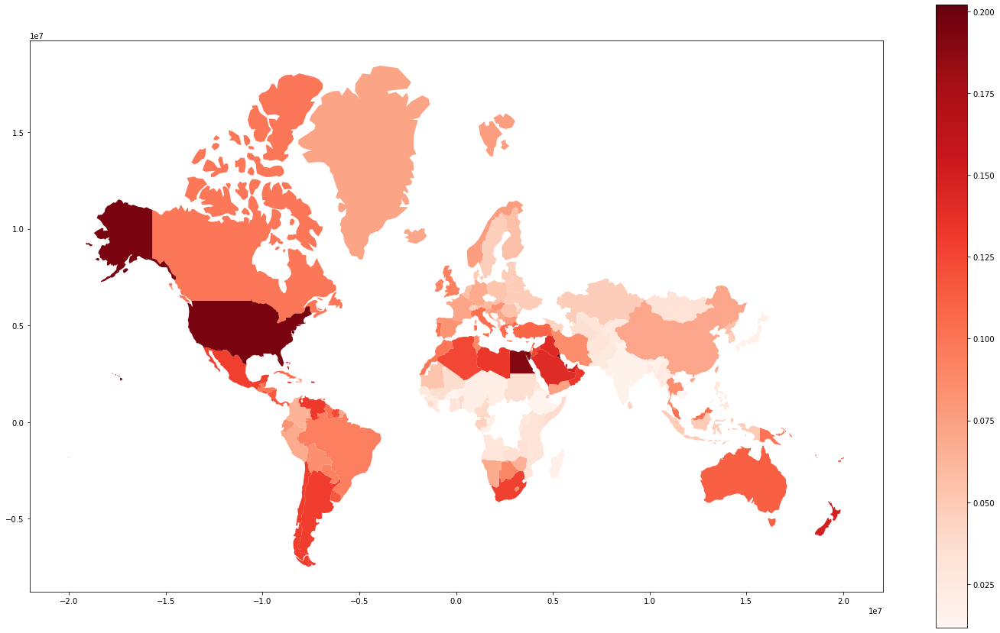

In [293]:
#Graph the Prevalence of obesity of all girls, in all countries included in the dataset and world, in 2016.
dataset["2016girl"].plot(column="Prevalence of BMI>2SD (obesity)", legend = True, cmap="Reds", figsize=(25, 15))

# These graphs show the prevelance of BMI numbers indicating obesity in different countries in girls

# Data Interpretation:

Due to many different factors in the world adolescent mean bmi and also prevalence of obesity has only been growing over the past 40 years. While on everage females rank lower than males when it comes to this data, the rise in BMI is shown just the same in many of the same countries. Places like the US are neck and shoulders above the majority of countries when it comes to this statistic, however the world at large is also getting better such as 3rd world countries finally having a more normal bmi scale as globalization and improvement of farming technology produce more and more crops for people to eat.

## Conclusion:

The figures generated show the BMI has increased in about every country overtime, some reacching helthy levels and other aproaching unhealthy levels.